In [80]:
library(ggplot2)
library(reshape2)
options(repr.plot.width=10, repr.plot.height=5, repr.plot.res=500)
oldw <- getOption("warn")
options(warn = -1)

In [16]:
N = 2000
features = matrix(runif(min = 0, max = 1, n = N), ncol = 1)
label = matrix(sin(6.5*features) + rnorm(N, mean = 0, sd = 0.1), ncol = 1)
data = data.frame(features, label)

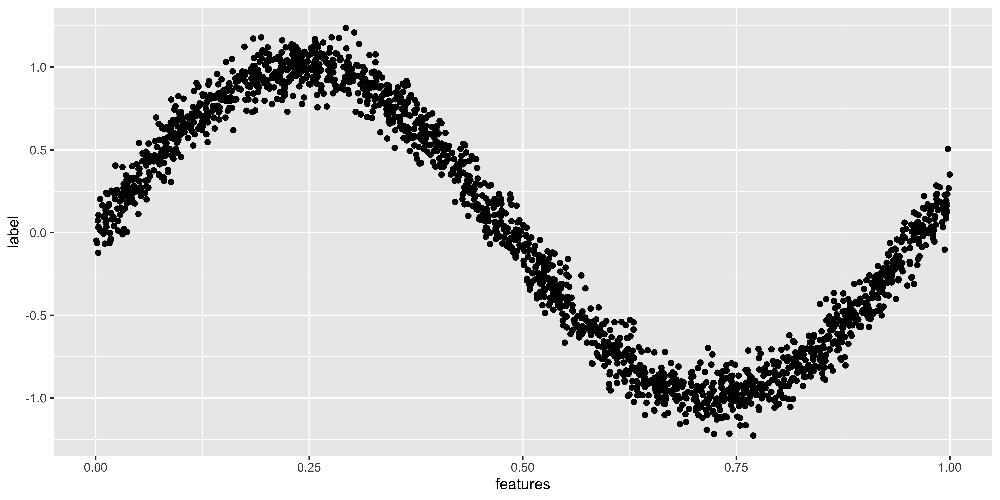

In [17]:
ggplot(data, aes(features, label)) + geom_point()

To do:

  split data into L mini datasets
  
  For each value m in 1: M do:
    * For each minidataset do:
            fit a polynomial of degree m
            save predictions of entire dataset
      calculate bias and variance corresponding to m
   
   Plot bias and variance against different values of M

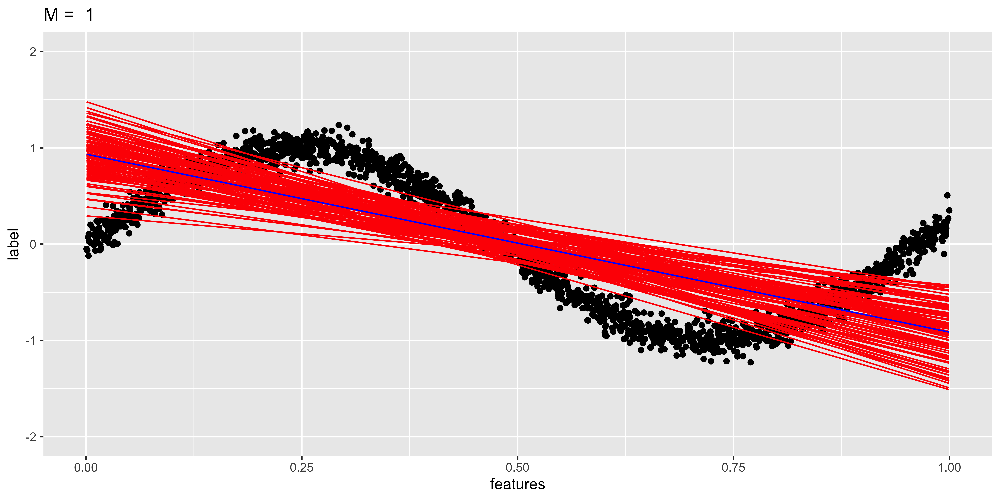

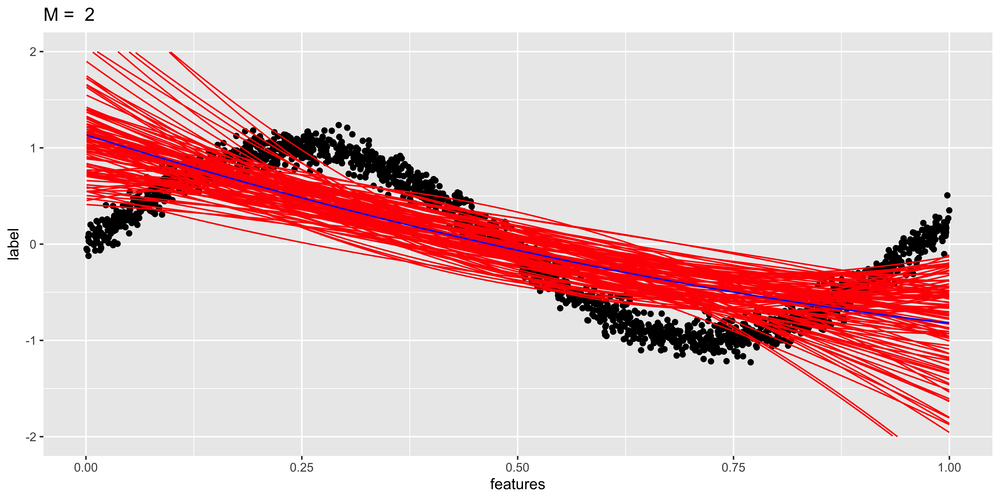

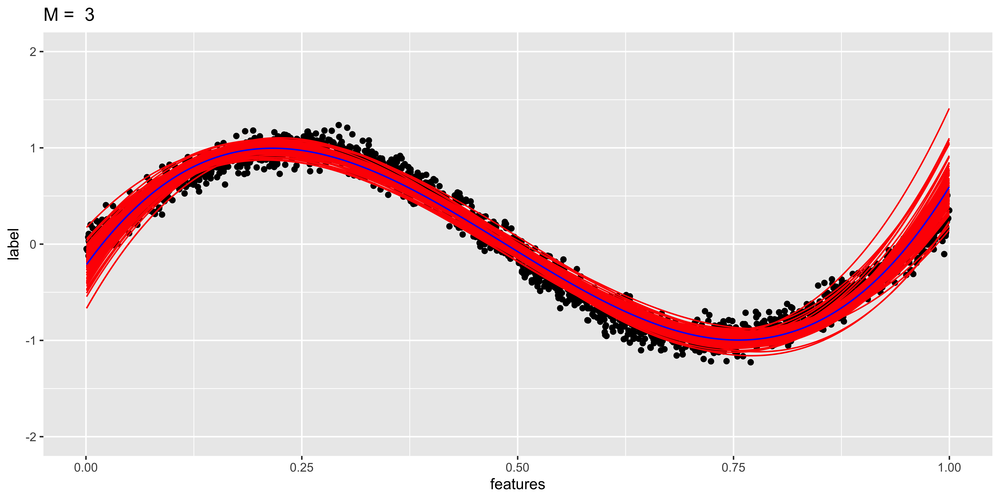

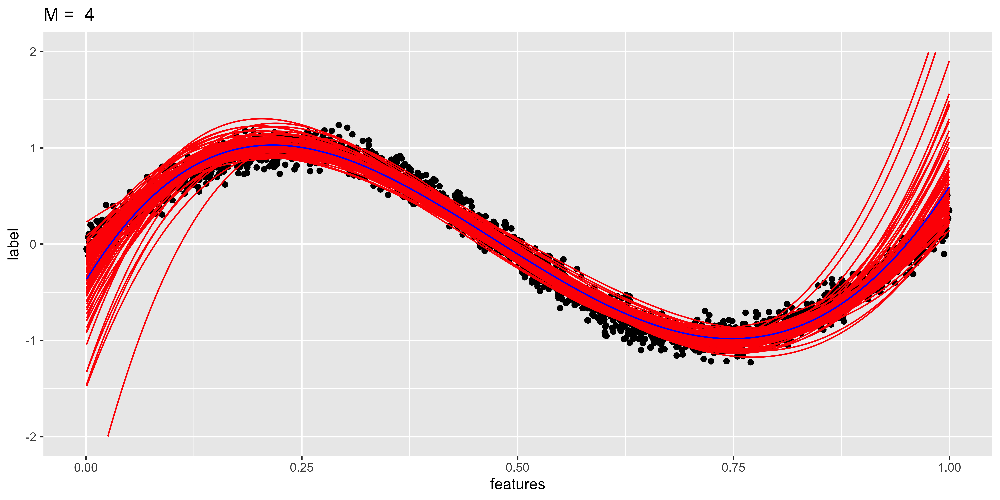

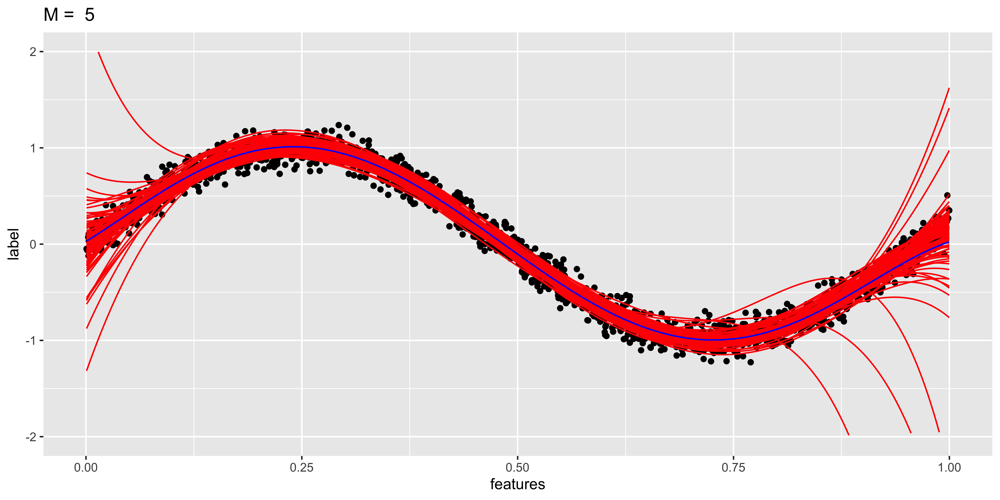

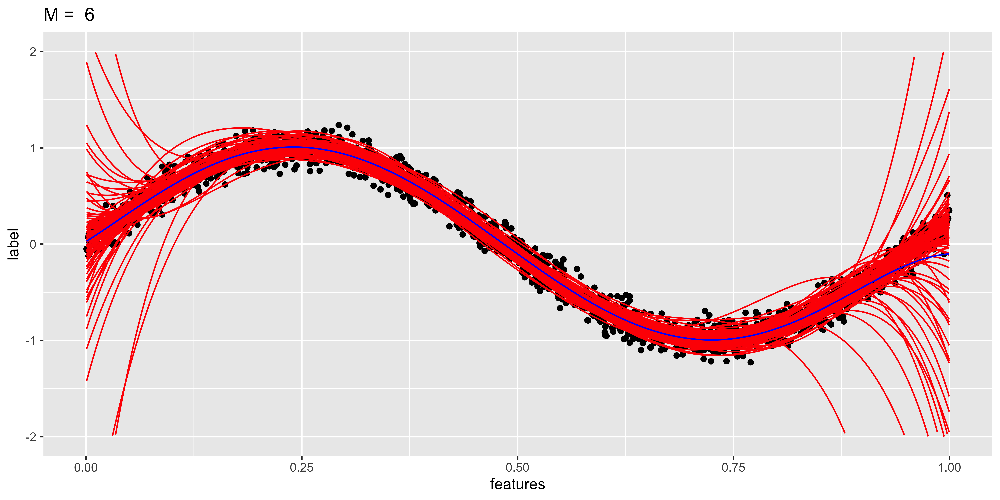

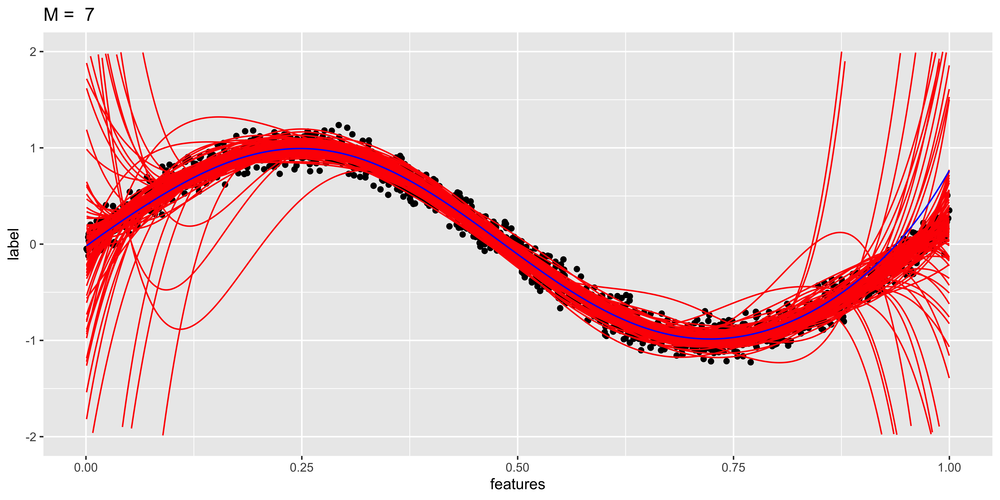

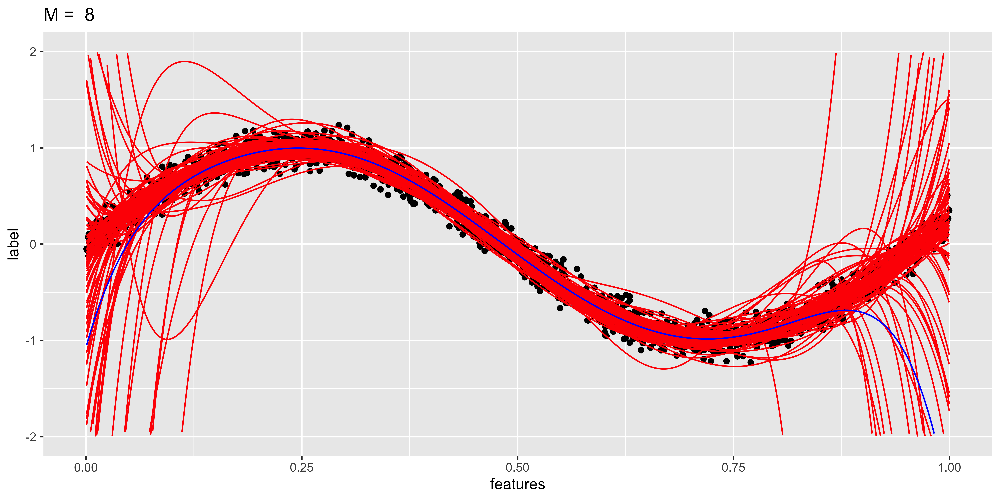

In [115]:
boot.idx <- t(matrix(seq(1,N), nrow = N/100))
M = 8
bias2_var = data.frame(M = 1:M, bias2 = 0, variance = 0)
lambda = 0

train.data <- cbind(1,features)
train.label <- label
for (m in 1:M){
    identity = diag(m+1)
    if (m != 1){
        train.data <- cbind(train.data, train.data[,2]^m)
    }
    g <- ggplot() + geom_point(data = data, mapping = aes(features, label)) + ggtitle(paste('M = ',m)) + 
    ylim(c(-2,2))
    
    preds_round <- matrix(,nrow = nrow(boot.idx), ncol = N)
    for (i in 1:nrow(boot.idx)){
        idx <- boot.idx[i,]
        mini.train <- train.data[idx,]
        mini.label <- train.label[idx]
        
        W <- solve(lambda * identity + t(mini.train)%*%mini.train)%*%t(mini.train)%*%mini.label
        predictions <- train.data %*% W
        preds_round[i,] <- predictions
        aux_data <- data.frame(features, predictions)
        g <- g + geom_line(data = aux_data, mapping = aes(features, predictions), color = 'red')
        
        
    }
    
    y_bar = matrix(colMeans(preds_round), nrow = 1)
    y_bar_repeated = t(matrix(rep(y_bar, times = nrow(preds_round)), ncol = nrow(preds_round)))
    
    bias2_var[m,'bias2'] <- mean((y_bar - matrix(label, nrow = 1))^2)
    bias2_var[m,'variance'] = mean(colMeans((preds_round - y_bar_repeated)^2))
    aux_data <- data.frame(features, predictions = colMeans(preds_round))
    g <- g + geom_line(data = aux_data, mapping = aes(features, predictions), color = 'blue')
    
    print(g)
    
}



Warning message:
“Removed 2 row(s) containing missing values (geom_path).”


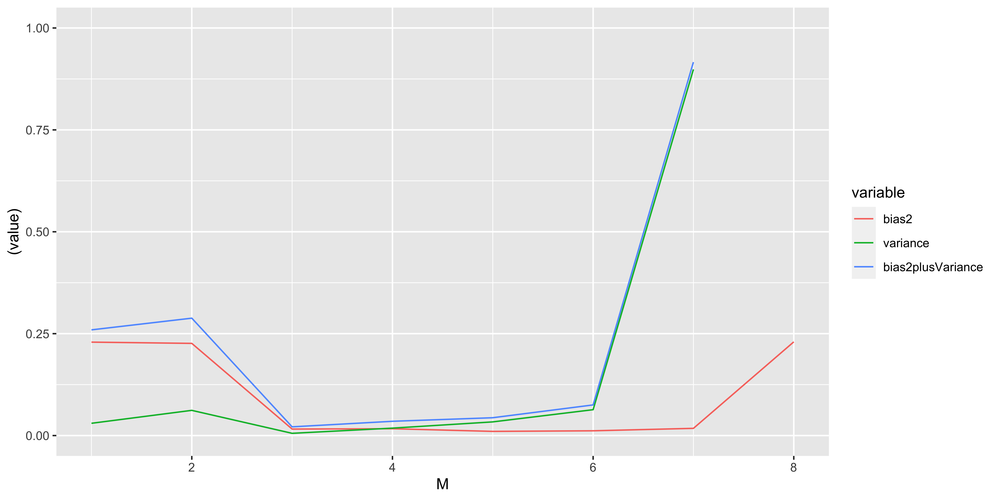

In [24]:
bias2_var[,'bias2plusVariance'] = bias2_var$bias2 + bias2_var$variance
toplot = melt(bias2_var,id.vars = 'M')
ggplot(toplot, aes(x = M, y = (value), color = variable)) + geom_line() + ylim(c(0,1))

In [11]:
bias2_var

M,bias2,variance,bias2plusVariance
<int>,<dbl>,<dbl>,<dbl>
1,0.23656405,0.030268384,0.26683244
2,0.24121863,0.128525377,0.36974401
3,0.01598156,0.006950802,0.02293237
4,0.02011310,0.045593449,0.06570655
5,0.01051612,0.066725087,0.07724121
6,0.02051636,0.392529263,0.41304562
7,0.04707642,9.411466184,9.45854260


### Fixing M and changing Lambda

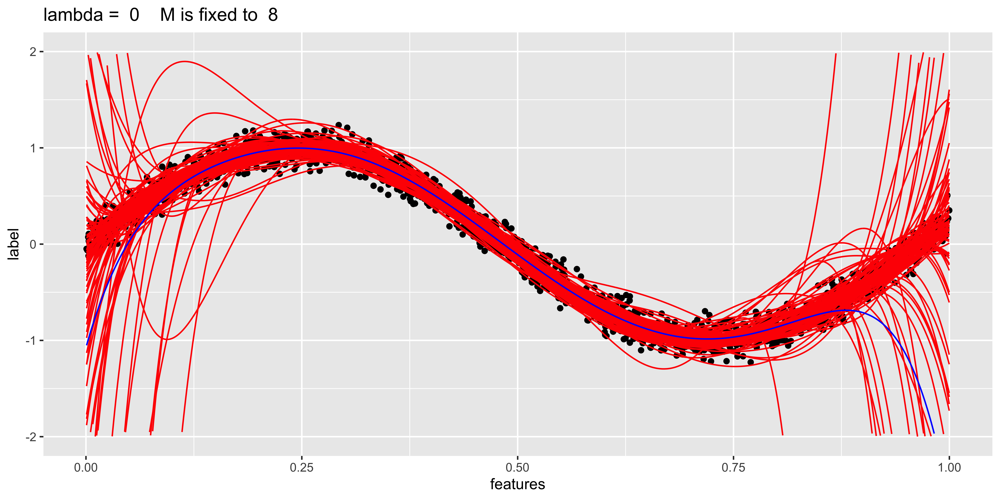

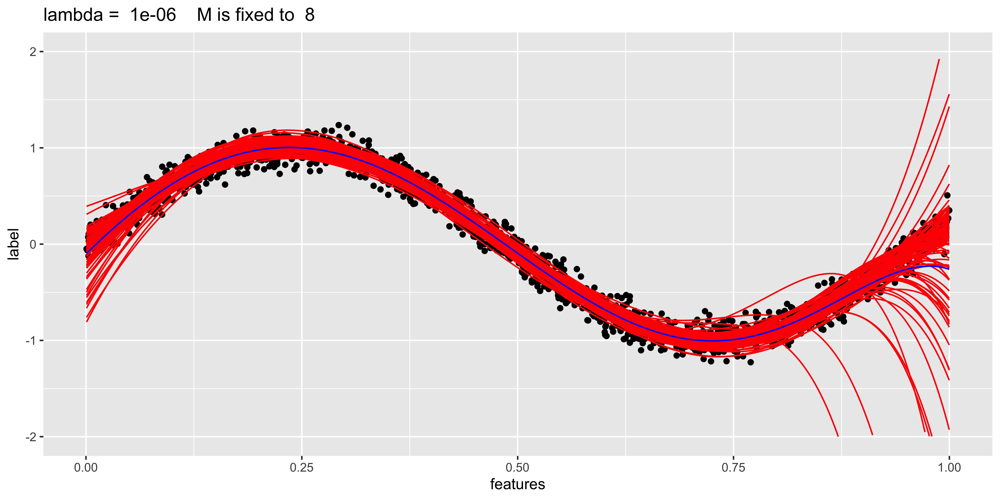

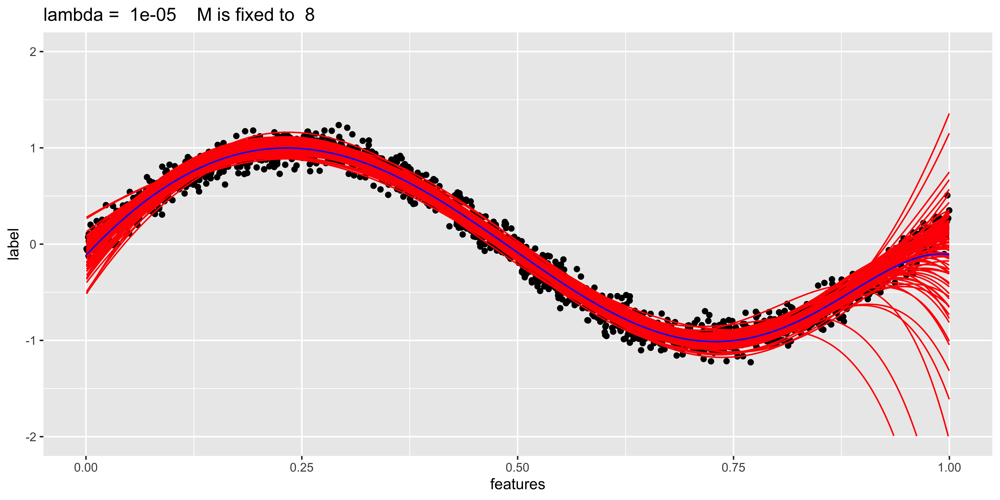

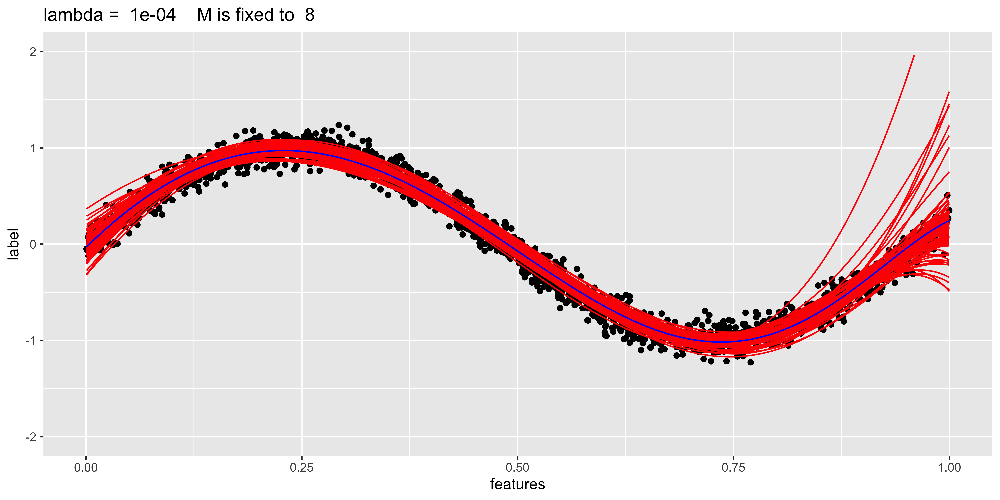

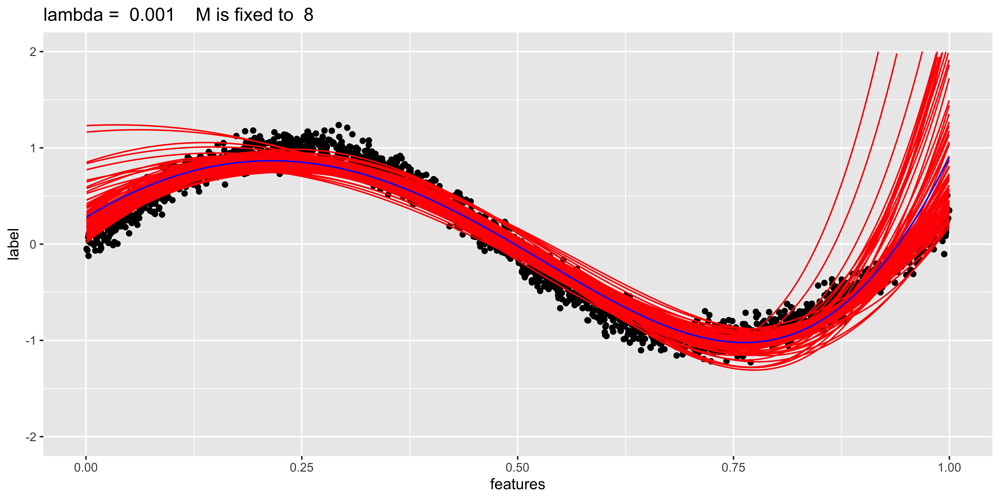

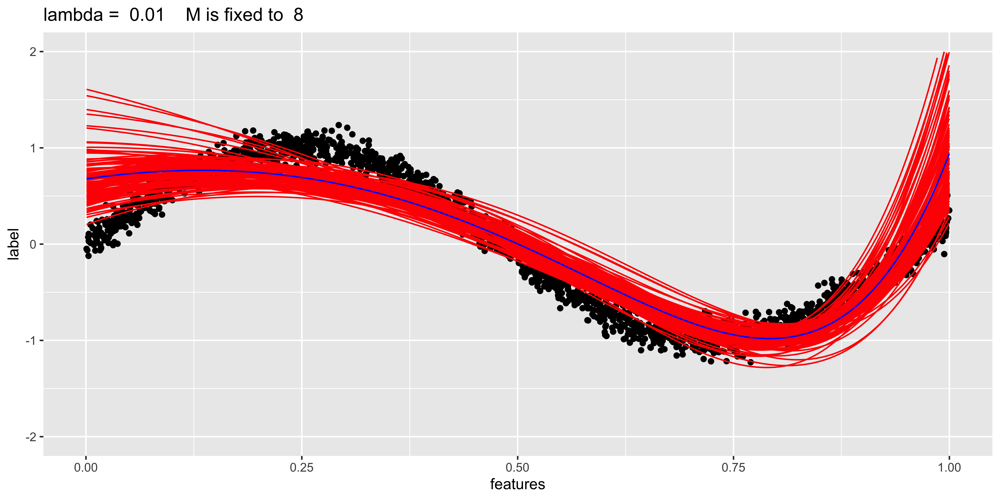

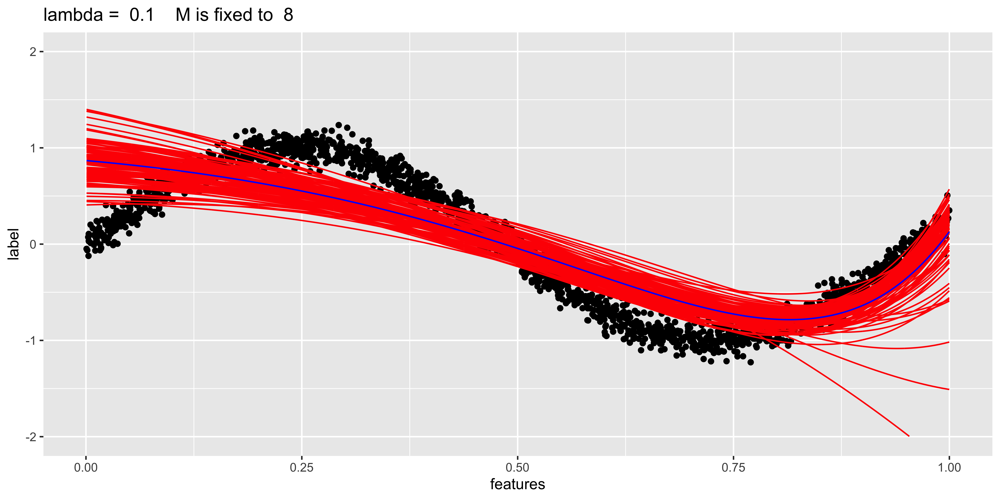

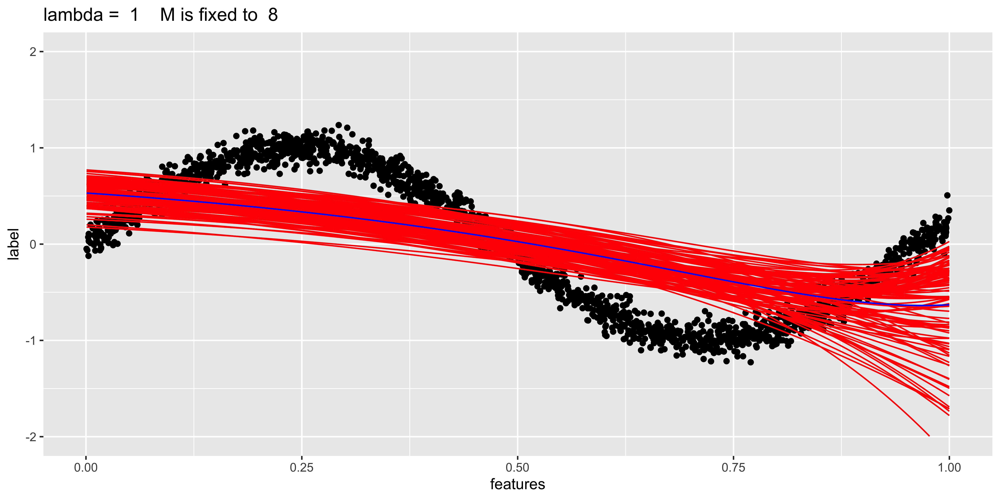

In [113]:
boot.idx <- t(matrix(seq(1,N), nrow = N/100))
M = 8

a = seq(-6, 0, by = 1)
lambdas = c(0,10^a)

bias2_var = data.frame(lambda = lambdas, bias2 = 0, variance = 0)
identity = diag(M+1)

train.data <- cbind(1,features)
train.label <- label

for (m in 1:M){
    if (m != 1){
        train.data <- cbind(train.data, train.data[,2]^m)
    }
}

for (l in 1:length(lambdas)){
    g <- ggplot() + geom_point(data = data, mapping = aes(features, label)) + ggtitle(paste('lambda = ',lambdas[l], '   M is fixed to ',M)) + 
    ylim(c(-2,2))
    
    preds_round <- matrix(,nrow = nrow(boot.idx), ncol = N)
    for (i in 1:nrow(boot.idx)){
        idx <- boot.idx[i,]
        mini.train <- train.data[idx,]
        mini.label <- train.label[idx]
        
        W <- solve(lambdas[l] * identity + t(mini.train)%*%mini.train)%*%t(mini.train)%*%mini.label
        predictions <- train.data %*% W
        preds_round[i,] <- predictions
        aux_data <- data.frame(features, predictions)
        g <- g + geom_line(data = aux_data, mapping = aes(features, predictions), color = 'red')
        
        
    }
    
    y_bar = matrix(colMeans(preds_round), nrow = 1)
    y_bar_repeated = t(matrix(rep(y_bar, times = nrow(preds_round)), ncol = nrow(preds_round)))
    
    bias2_var[l,'bias2'] <- mean((y_bar - matrix(label, nrow = 1))^2)
    bias2_var[l,'variance'] = mean(colMeans((preds_round - y_bar_repeated)^2))
    aux_data <- data.frame(features, predictions = colMeans(preds_round))
    g <- g + geom_line(data = aux_data, mapping = aes(features, predictions), color = 'blue')
    
    print(g)
    
}



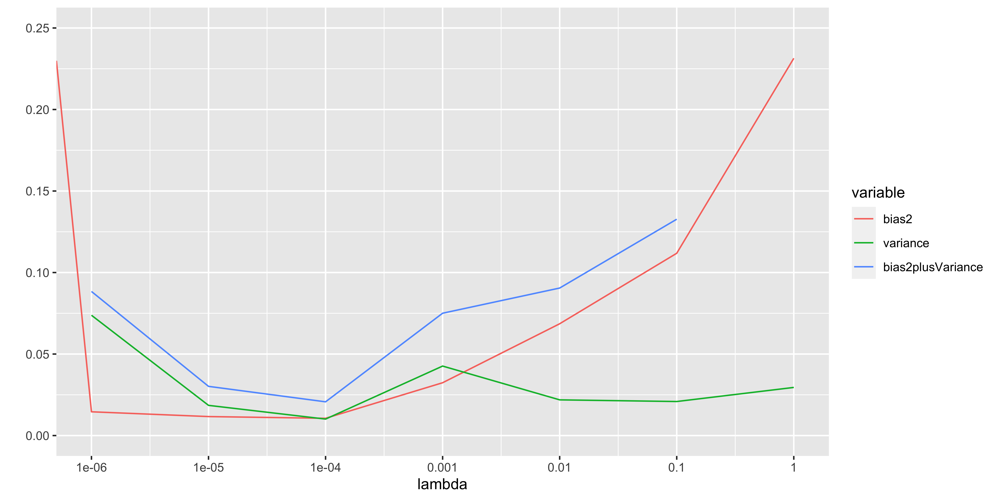

In [112]:
bias2_var[,'bias2plusVariance'] = bias2_var$bias2 + bias2_var$variance
toplot = melt(bias2_var,id.vars = 'lambda')
ggplot(toplot, aes(x = log(lambda), y = (value), color = variable)) + geom_line() + ylim(c(0,0.25))+ ylab('') +
    scale_x_continuous(name="lambda", breaks = log(lambdas), labels = lambdas)

In [ ]:
options(warn = oldw)